In [1]:
exp_no = 2
_iterations = 100000
batch_size = _batch_size = 32
nb_classes = _nb_classes = 5
nb_samples_per_class = _nb_samples_per_class = 10
_input_height = _input_width = 60
img_size = (_input_height, _input_width)
colorspace = 'RGB'
channels = {'RGB':3, 'L':1}
input_size = _input_height * _input_width * channels[colorspace]
cell = 'DNC'
nb_reads = _nb_reads = 1
controller_size = _controller_size = 100
memory_size = _memory_locations = 128
memory_dim = ar_memory_word_size = 20
summary_interval = 100
checkpt_write_interval = 1000
dataset = 'vgg_flower'
pre_scale=(100,100)
augment=False
splits=[70,15,15]

learning_rate = _learning_rate = 1e-3
start=0
save_dir='./Experiments_New'
_start_iterations = 0

In [3]:
from datetime import datetime
from packaging import version
import os
import sys
sys.path.append('./metalearning')
os.environ["RECORDS"]="./datasets/Records"

In [4]:
%load_ext tensorboard

In [5]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

from metalearning_tasks.fixed_shot_classification_v2 import DatasetGenerator
from models.model_builder import create_one_hot_model

In [6]:
train_loss = tf.keras.metrics.Mean('train_loss', dtype=tf.float32)
train_error = tf.keras.metrics.Mean('train_error', dtype=tf.float32)

In [7]:
try:
  with open(f"{save_dir}/{dataset}/{cell}/{learning_rate}/{exp_no}" + "/model.iteration") as f:
    _start_iterations =  int(f.read())
except Exception:
  print("Not reloading from checkpoint")


In [8]:
%tensorboard --logdir '{save_dir}'

Reusing TensorBoard on port 6007 (pid 638074), started 15 days, 19:44:11 ago. (Use '!kill 638074' to kill it.)

In [9]:
def metric_accuracy(_nb_classes,_nb_samples_per_class,labels, outputs):
    seq_length = _nb_classes * _nb_samples_per_class
    outputs = np.argmax(outputs, axis=-1)
    correct = [0] * seq_length
    total = [0] * seq_length
    for i in range(np.shape(labels)[0]):
        label = labels[i]
        output = outputs[i]
        class_count = {}
        for j in range(seq_length):
            class_count[label[j]] = class_count.get(label[j], 0) + 1
            total[class_count[label[j]]] += 1
            if label[j] == output[j]:
                correct[class_count[label[j]]] += 1
    return [float(correct[i]) / total[i] if total[i] > 0. else 0.
            for i in range(1, _nb_samples_per_class + 1)]
last_logged_ep=0
def train(model, data_genarator, _start_iterations, _iterations, _learning_rate, cell, _batch_size, _nb_classes, save_dir):
    optimizer = tf.keras.optimizers.Adam(lr=_learning_rate)
    print("1st\t2nd\t3rd\t4th\t5th\t6th\t7th\t8th\t9th\t10th\tbatch\tloss\tdt")
    logdir = f"{save_dir}/{dataset}/{cell}/{_learning_rate}/{exp_no}/logs"
    summary_writer = tf.summary.create_file_writer(logdir)
    dt = datetime.now()
    accuracies = []
    losses = []
    for ep in range(_start_iterations, _iterations):
        if ep % summary_interval == 0:
            image, label = data_genarator.generate_batch("train",
                                                         _batch_size)
            one_hot_target = tf.one_hot(label, _nb_classes, axis=-1)
            offset_target_var = tf.concat([tf.zeros_like(tf.expand_dims(
                one_hot_target[:, 0], 1)), one_hot_target[:, :-1]], axis=1)
            ntm_input = tf.concat([image, offset_target_var], axis=2)
            output = model(ntm_input)
            loss = tf.reduce_mean(
                        tf.reduce_sum(
                            tf.nn.softmax_cross_entropy_with_logits(
                                labels=one_hot_target,
                                logits=output),
                            axis=1))
            accuracy = metric_accuracy(_nb_classes, _nb_samples_per_class, label, output)
            accuracies.append((ep,accuracy))
            dt = datetime.now() - dt

            for accu in accuracy:
                print('%.4f' % accu, end='\t')
            print('%d\t%.4f\t%.4f' % (ep, loss, dt.total_seconds()))
            train_loss(loss)
            losses.append((ep,train_loss.result()))

            dt = datetime.now()
        if ep % checkpt_write_interval == 1 and ep > 0:
            model.save_weights(f"{save_dir}/{dataset}/{cell}/{_learning_rate}/{exp_no}" + "/model.")
            with open(f"{save_dir}/{dataset}/{cell}/{_learning_rate}/{exp_no}" + "/model.iteration", 'w') as f:
                _start_iterations =  f.write(str(ep))
            with summary_writer.as_default():
              for ep_idx, accuracy in accuracies:
                for i, accu in enumerate(accuracy):
                    tf.summary.scalar(f'train_acc_{i}',
                                      accu,
                                      step=ep_idx)
              for ep_idx, loss_res in losses:
                tf.summary.scalar('train_loss',
                                  train_loss.result(),
                                  step=ep_idx)
            last_logged_ep=ep
            accuracies=[]
            losses=[]
        image, label = data_genarator.generate_batch("train", _batch_size)
        one_hot_target = tf.one_hot(label, _nb_classes, axis=-1)
        offset_target_var = tf.concat([tf.zeros_like(tf.expand_dims(
            one_hot_target[:, 0], 1)), one_hot_target[:, :-1]], axis=1)
        ntm_input = tf.concat([image, offset_target_var], axis=2)
        with tf.GradientTape() as tape:
            output = model(ntm_input)
            loss = tf.reduce_mean(
                        tf.reduce_sum(
                            tf.nn.softmax_cross_entropy_with_logits(
                                labels=one_hot_target,
                                logits=output
                            ),
                            axis=1)
                      )
            grads, _ = tf.clip_by_global_norm(
                tape.gradient(loss, model.trainable_variables),
                50)
        optimizer.apply_gradients(zip(grads, model.trainable_variables))
        train_loss(loss)


In [10]:
model = create_one_hot_model(
                              input_size+_nb_classes,
                              _nb_classes,
                              _batch_size,
                              cell)
ds_root = f'./datasets/Records/{dataset}'
data_generator = DatasetGenerator(data_folder=ds_root,
                                  splits=splits,
                                  nb_classes=_nb_classes,
                                  nb_samples_per_class=nb_samples_per_class,
                                  img_size=img_size,
                                  colorspace=colorspace)

In [11]:
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(32, None, 10805)]       0         
_________________________________________________________________
tf.stop_gradient (TFOpLambda (32, None, 10805)         0         
_________________________________________________________________
rnn (RNN)                    (32, None, 5)             4379893   
_________________________________________________________________
dense (Dense)                (32, None, 5)             30        
_________________________________________________________________
softmax (Softmax)            (32, None, 5)             0         
Total params: 4,379,923
Trainable params: 4,379,923
Non-trainable params: 0
_________________________________________________________________


In [10]:
try:
  model.load_weights(f"{save_dir}/{dataset}/{cell}/{learning_rate}/{exp_no}" + "/model.")
except:
  print("No weights loaded")

In [11]:
import matplotlib.pyplot as plt

In [12]:
b1 = data_generator.generate_batch('train', 32)

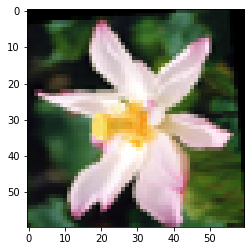

In [13]:
plt.imshow(tf.reshape(b1[0][0,0,:],(60,60,3)))

In [ ]:
train(model, data_generator, _start_iterations, _iterations, _learning_rate, cell, _batch_size, _nb_classes, save_dir)

1st	2nd	3rd	4th	5th	6th	7th	8th	9th	10th	batch	loss	dt
0.2000	0.2000	0.2000	0.2000	0.2025	0.2065	0.1875	0.1880	0.1933	0.1875	71100	80.4725	138.3418
0.2000	0.2000	0.2000	0.2000	0.2038	0.2051	0.2095	0.1866	0.1552	0.1304	71200	80.4719	137.5995
0.2000	0.2000	0.2000	0.2000	0.2000	0.2000	0.1921	0.1912	0.1712	0.1556	71300	80.4758	137.7713
0.2000	0.2000	0.2000	0.2025	0.2051	0.2078	0.2138	0.1985	0.1949	0.2000	71400	80.4670	137.3683
0.2000	0.2000	0.2000	0.2000	0.2025	0.1961	0.1837	0.1953	0.1892	0.1818	71500	80.4733	137.5710
0.2000	0.2000	0.2000	0.2000	0.1987	0.2013	0.2158	0.2097	0.2000	0.2022	71600	80.4723	137.9341
0.2000	0.2000	0.2013	0.2013	0.1975	0.2000	0.2013	0.2143	0.2258	0.2043	71700	80.4705	113.6125
0.2000	0.2013	0.2013	0.2013	0.1987	0.1987	0.1958	0.1870	0.2130	0.2022	71800	80.4734	94.3048
0.2000	0.2000	0.2000	0.2000	0.2000	0.2065	0.2081	0.2045	0.2091	0.2022	71900	80.4714	93.8989
0.2000	0.2000	0.2000	0.2000	0.1962	0.2039	0.2168	0.2331	0.2342	0.2500	72000	80.4688	94.0644
0.2000	0.2000	0.20